In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import re
from datetime import datetime

In [2]:
df = pd.read_csv('train.csv')
df2 = df.copy()
test = pd.read_csv('test.csv')
test2 = test.copy()

In [3]:
df2 = pd.read_csv('train.csv')
sub = pd.read_csv('submission.csv')

In [4]:
df2.head()

,ID,Levy,Manufacturer,Model,Prod. year,Category,Leather interior,Fuel type,Engine volume,Mileage,Cylinders,Gear box type,Drive wheels,Doors,Wheel,Color,Airbags,Price
0,45654403,1399,LEXUS,RX 450,2010,Jeep,Yes,Hybrid,3.5,186005 km,6,Automatic,4x4,4-May,Left wheel,Silver,12,13328
1,44731507,1018,CHEVROLET,Equinox,2011,Jeep,No,Petrol,3,192000 km,6,Tiptronic,4x4,4-May,Left wheel,Black,8,16621
2,45774419,-,HONDA,FIT,2006,Hatchback,No,Petrol,1.3,200000 km,4,Variator,Front,4-May,Right-hand drive,Black,2,8467
3,45769185,862,FORD,Escape,2011,Jeep,Yes,Hybrid,2.5,168966 km,4,Automatic,4x4,4-May,Left wheel,White,0,3607
4,45809263,446,HONDA,FIT,2014,Hatchback,Yes,Petrol,1.3,91901 km,4,Automatic,Front,4-May,Left wheel,Silver,4,11726


In [5]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19237 entries, 0 to 19236
Data columns (total 18 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   ID                19237 non-null  int64 
 1   Levy              19237 non-null  object
 2   Manufacturer      19237 non-null  object
 3   Model             19237 non-null  object
 4   Prod. year        19237 non-null  int64 
 5   Category          19237 non-null  object
 6   Leather interior  19237 non-null  object
 7   Fuel type         19237 non-null  object
 8   Engine volume     19237 non-null  object
 9   Mileage           19237 non-null  object
 10  Cylinders         19237 non-null  int64 
 11  Gear box type     19237 non-null  object
 12  Drive wheels      19237 non-null  object
 13  Doors             19237 non-null  object
 14  Wheel             19237 non-null  object
 15  Color             19237 non-null  object
 16  Airbags           19237 non-null  int64 
 17  Price       

In [6]:
df2['Doors'].value_counts()

4-May    18332
2-Mar      777
>5         128
Name: Doors, dtype: int64

In [7]:
df2.groupby('Levy').mean().sort_values('Price',ascending=False)

,ID,Prod. year,Cylinders,Airbags,Price
Levy,,,,,
2067,45704136.5,2019.0,8.0,6.0,449958.5
2269,45760644.0,2018.0,8.0,0.0,288521.0
2819,45813777.0,2016.0,8.0,12.0,175622.0
1951,45806776.0,2015.0,8.0,14.0,128188.5
3057,45773951.0,2019.0,12.0,12.0,121524.0
...,...,...,...,...,...
2472,45773126.0,2003.0,6.0,12.0,314.0
1297,45771563.0,2011.0,6.0,12.0,314.0
1279,45812580.0,2003.0,4.0,11.0,150.0


In [8]:
test2[(test2['Manufacturer'] == 'OPEL') & (test2['Prod. year']<=1999)]

,ID,Levy,Manufacturer,Model,Prod. year,Category,Leather interior,Fuel type,Engine volume,Mileage,Cylinders,Gear box type,Drive wheels,Doors,Wheel,Color,Airbags
4,45814303,-,OPEL,Astra,1993,Hatchback,No,Petrol,1.6,200000 km,4,Manual,Front,4-May,Left wheel,Black,0
78,45793325,-,OPEL,Vectra,1999,Hatchback,No,CNG,1.8,30000 km,4,Manual,Front,4-May,Left wheel,Silver,4
109,45801493,-,OPEL,Astra,1992,Hatchback,No,CNG,1.6,10000 km,4,Manual,Front,4-May,Left wheel,Carnelian red,0
327,45785886,-,OPEL,Corsa,1997,Hatchback,No,Petrol,1.4,220000 km,4,Manual,Front,4-May,Left wheel,Carnelian red,2
349,45770466,-,OPEL,Astra,1997,Sedan,No,Petrol,1.6,0 km,4,Automatic,Front,4-May,Left wheel,Red,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7678,45798317,-,OPEL,Vectra,1999,Sedan,No,Petrol,1.8,222222 km,4,Manual,Front,4-May,Left wheel,Sky blue,4
7733,45808778,-,OPEL,Vectra,1992,Sedan,No,CNG,2,25000 km,4,Manual,Front,4-May,Left wheel,Grey,2
7980,45794535,-,OPEL,Astra,1996,Coupe,No,Petrol,2,999 km,4,Manual,Front,2-Mar,Left wheel,Green,2
8084,45789587,-,OPEL,Vectra,1997,Sedan,No,Petrol,1.6,250000 km,4,Manual,Front,>5,Left wheel,Beige,0


In [9]:
df2.groupby('Cylinders').mean().sort_values('Price',ascending=False)

,ID,Prod. year,Airbags,Price
Cylinders,,,,
12,4.519357e+07,2011.184211,10.368421,39757.131579
10,4.432546e+07,2008.416667,10.833333,31486.666667
8,4.545564e+07,2010.040363,6.349142,28198.847629
4,4.560082e+07,2011.377810,6.058607,18436.320874
16,4.577747e+07,2007.000000,8.800000,17519.800000
6,4.553892e+07,2009.558348,8.894281,16618.038417
1,4.533292e+07,2005.236842,3.263158,16375.105263
14,4.579753e+07,2009.000000,8.000000,15681.000000
5,4.549286e+07,2007.710059,6.940828,14640.213018


In [10]:
def cylinder_mean(s):
    if s == 12:
        s = 39757
    elif s == 10:
        s = 31486
    elif s == 8:
        s = 28198
    elif s == 4:
        s = 18436
    elif s == 16:
        s = 17519
    elif s == 6:
        s = 16618
    elif s == 1:
        s = 16375
    elif s == 14:
        s = 15681
    elif s == 5:
        s = 14640
    elif s == 2:
        s = 10358
    elif s == 3:
        s = 9879
    elif s == 7:
        s = 6446
    else:
        s = 2800
        
    return int(s)

In [11]:
df['Cylinder_mean'] = df['Cylinders'].apply(cylinder_mean)

test['Cylinder_mean'] = test['Cylinders'].apply(cylinder_mean)

In [12]:
def gear_box_mean(s):
    if s == 'Tiptronic':
        s = 26448
    elif s == 'Manual':
        s = 25614
    elif s == 'Automatic':
        s = 15974
    else:
        s = 14762
    return int(s)

In [13]:
df['Gear box type_mean'] = df['Gear box type'].apply(gear_box_mean)

test['Gear box type_mean'] = test['Gear box type'].apply(gear_box_mean)

In [14]:
def color_mean(s):
    if s == 'Blue':
        s = 33726
    elif s == 'Yellow':
        s = 20666
    elif s == 'Brown':
        s = 19709
    elif s == 'Grey':
        s = 19203
    elif s == 'Black':
        s = 18886
    elif s == 'White':
        s = 18204
    elif s == 'Carnelian red':
        s = 15820
    elif s == 'Beige':
        s = 15627
    elif s == 'Silver':
        s = 15091
    elif s == 'Golden':
        s = 14678
    elif s == 'Sky blue':
        s = 14079
    elif s == 'Red':
        s = 13553
    elif s == 'Orange':
        s = 13008
    elif s == 'Pink':
        s = 10649
    elif s == 'Green':
        s = 9449
    else:
        s = 8837
        
    return int(s)

In [15]:
df['Color_mean'] = df['Color'].apply(color_mean)

test['Color_mean'] = test['Color'].apply(color_mean)

In [16]:
df2

,ID,Levy,Manufacturer,Model,Prod. year,Category,Leather interior,Fuel type,Engine volume,Mileage,Cylinders,Gear box type,Drive wheels,Doors,Wheel,Color,Airbags,Price
0,45654403,1399,LEXUS,RX 450,2010,Jeep,Yes,Hybrid,3.5,186005 km,6,Automatic,4x4,4-May,Left wheel,Silver,12,13328
1,44731507,1018,CHEVROLET,Equinox,2011,Jeep,No,Petrol,3,192000 km,6,Tiptronic,4x4,4-May,Left wheel,Black,8,16621
2,45774419,-,HONDA,FIT,2006,Hatchback,No,Petrol,1.3,200000 km,4,Variator,Front,4-May,Right-hand drive,Black,2,8467
3,45769185,862,FORD,Escape,2011,Jeep,Yes,Hybrid,2.5,168966 km,4,Automatic,4x4,4-May,Left wheel,White,0,3607
4,45809263,446,HONDA,FIT,2014,Hatchback,Yes,Petrol,1.3,91901 km,4,Automatic,Front,4-May,Left wheel,Silver,4,11726
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19232,45798355,-,MERCEDES-BENZ,CLK 200,1999,Coupe,Yes,CNG,2.0 Turbo,300000 km,4,Manual,Rear,2-Mar,Left wheel,Silver,5,8467
19233,45778856,831,HYUNDAI,Sonata,2011,Sedan,Yes,Petrol,2.4,161600 km,4,Tiptronic,Front,4-May,Left wheel,Red,8,15681
19234,45804997,836,HYUNDAI,Tucson,2010,Jeep,Yes,Diesel,2,116365 km,4,Automatic,Front,4-May,Left wheel,Grey,4,26108
19235,45793526,1288,CHEVROLET,Captiva,2007,Jeep,Yes,Diesel,2,51258 km,4,Automatic,Front,4-May,Left wheel,Black,4,5331


In [17]:
def category_mean(s):
    if s == 'Goods wagon':
        s = 122916
    elif s == 'Pickup':
        s = 28805
    elif s == 'Universal':
        s = 25253
    elif s == 'Cabriolet':
        s = 24583
    elif s == 'Jeep':
        s = 23684
    elif s == 'Coupe':
        s = 21250
    elif s == 'Minivan':
        s = 20531
    elif s == 'Microbus':
        s = 18550
    elif s == 'Sedan':
        s = 14231
    elif s == 'Limousine':
        s = 11534
    else:
        s = 11381
        
    return int(s)

In [18]:
df['Category_mean'] = df['Category'].apply(category_mean)

test['Category_mean'] = test['Category'].apply(category_mean)

In [19]:
def doors_mean(s):
    if s == '2-Mar':
        s = 50379
    elif s == '>5':
        s = 22299
    else:
        s = 17180
    return int(s)

In [20]:
df['Doors_mean'] = df['Doors'].apply(doors_mean)

test['Doors_mean'] = test['Doors'].apply(doors_mean)

In [21]:
df['Wheel_mean'] = df['Wheel'].apply(lambda x: 19363 if x == 'Left wheel' else 8900)

test['Wheel_mean'] = test['Wheel'].apply(lambda x: 19363 if x == 'Left wheel' else 8900)

In [22]:
df

,ID,Levy,Manufacturer,Model,Prod. year,Category,Leather interior,Fuel type,Engine volume,Mileage,...,Wheel,Color,Airbags,Price,Cylinder_mean,Gear box type_mean,Color_mean,Category_mean,Doors_mean,Wheel_mean
0,45654403,1399,LEXUS,RX 450,2010,Jeep,Yes,Hybrid,3.5,186005 km,...,Left wheel,Silver,12,13328,16618,15974,15091,23684,17180,19363
1,44731507,1018,CHEVROLET,Equinox,2011,Jeep,No,Petrol,3,192000 km,...,Left wheel,Black,8,16621,16618,26448,18886,23684,17180,19363
2,45774419,-,HONDA,FIT,2006,Hatchback,No,Petrol,1.3,200000 km,...,Right-hand drive,Black,2,8467,18436,14762,18886,11381,17180,8900
3,45769185,862,FORD,Escape,2011,Jeep,Yes,Hybrid,2.5,168966 km,...,Left wheel,White,0,3607,18436,15974,18204,23684,17180,19363
4,45809263,446,HONDA,FIT,2014,Hatchback,Yes,Petrol,1.3,91901 km,...,Left wheel,Silver,4,11726,18436,15974,15091,11381,17180,19363
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19232,45798355,-,MERCEDES-BENZ,CLK 200,1999,Coupe,Yes,CNG,2.0 Turbo,300000 km,...,Left wheel,Silver,5,8467,18436,25614,15091,21250,50379,19363
19233,45778856,831,HYUNDAI,Sonata,2011,Sedan,Yes,Petrol,2.4,161600 km,...,Left wheel,Red,8,15681,18436,26448,13553,14231,17180,19363
19234,45804997,836,HYUNDAI,Tucson,2010,Jeep,Yes,Diesel,2,116365 km,...,Left wheel,Grey,4,26108,18436,15974,19203,23684,17180,19363
19235,45793526,1288,CHEVROLET,Captiva,2007,Jeep,Yes,Diesel,2,51258 km,...,Left wheel,Black,4,5331,18436,15974,18886,23684,17180,19363


In [23]:
df2

,ID,Levy,Manufacturer,Model,Prod. year,Category,Leather interior,Fuel type,Engine volume,Mileage,Cylinders,Gear box type,Drive wheels,Doors,Wheel,Color,Airbags,Price
0,45654403,1399,LEXUS,RX 450,2010,Jeep,Yes,Hybrid,3.5,186005 km,6,Automatic,4x4,4-May,Left wheel,Silver,12,13328
1,44731507,1018,CHEVROLET,Equinox,2011,Jeep,No,Petrol,3,192000 km,6,Tiptronic,4x4,4-May,Left wheel,Black,8,16621
2,45774419,-,HONDA,FIT,2006,Hatchback,No,Petrol,1.3,200000 km,4,Variator,Front,4-May,Right-hand drive,Black,2,8467
3,45769185,862,FORD,Escape,2011,Jeep,Yes,Hybrid,2.5,168966 km,4,Automatic,4x4,4-May,Left wheel,White,0,3607
4,45809263,446,HONDA,FIT,2014,Hatchback,Yes,Petrol,1.3,91901 km,4,Automatic,Front,4-May,Left wheel,Silver,4,11726
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19232,45798355,-,MERCEDES-BENZ,CLK 200,1999,Coupe,Yes,CNG,2.0 Turbo,300000 km,4,Manual,Rear,2-Mar,Left wheel,Silver,5,8467
19233,45778856,831,HYUNDAI,Sonata,2011,Sedan,Yes,Petrol,2.4,161600 km,4,Tiptronic,Front,4-May,Left wheel,Red,8,15681
19234,45804997,836,HYUNDAI,Tucson,2010,Jeep,Yes,Diesel,2,116365 km,4,Automatic,Front,4-May,Left wheel,Grey,4,26108
19235,45793526,1288,CHEVROLET,Captiva,2007,Jeep,Yes,Diesel,2,51258 km,4,Automatic,Front,4-May,Left wheel,Black,4,5331


In [24]:
df2.groupby(['Prod. year', 'Cylinders']).mean().sort_values('Price',ascending=False)

ID    Airbags          Price
Prod. year Cylinders                                        
2020       8          4.579552e+07  12.000000  627220.000000
1999       4          4.567959e+07   3.414966  186062.530612
2017       1          4.458755e+07   0.000000  147397.000000
2019       8          4.541621e+07  10.300000  140659.100000
           12         4.577395e+07  12.000000  121524.000000
...                            ...        ...            ...
1947       6          3.816900e+07   0.000000     150.000000
2009       2          4.576165e+07   2.000000      60.000000
2007       7          4.574188e+07   9.000000      40.000000
2011       7          4.537004e+07  12.000000      30.000000
2020       12         4.581498e+07   0.000000       3.000000

[239 rows x 3 columns]

In [25]:
df.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
ID,19237.0,4.557654e+07,936591.422799,20746880.0,45698374.0,45772308.0,45802036.0,45816654.0
Prod. year,19237.0,2.010913e+03,5.668673,1939.0,2009.0,2012.0,2015.0,2020.0
Cylinders,19237.0,4.582991e+00,1.199933,1.0,4.0,4.0,4.0,16.0
Airbags,19237.0,6.582627e+00,4.320168,0.0,4.0,6.0,12.0,16.0
Price,19237.0,1.855593e+04,190581.269684,1.0,5331.0,13172.0,22075.0,26307500.0
Cylinder_mean,19237.0,1.855563e+04,2687.425049,2800.0,18436.0,18436.0,18436.0,39757.0
Gear box type_mean,19237.0,1.855555e+04,4487.917785,14762.0,15974.0,15974.0,25614.0,26448.0
Color_mean,19237.0,1.855529e+04,4741.821189,8837.0,15091.0,18204.0,18886.0,33726.0
Category_mean,19237.0,1.855551e+04,12533.020219,11381.0,14231.0,14231.0,23684.0,122916.0
Doors_mean,19237.0,1.855500e+04,6542.458234,17180.0,17180.0,17180.0,17180.0,50379.0


In [26]:
df2['Fuel type'].value_counts()

Petrol            10150
Diesel             4036
Hybrid             3578
LPG                 892
CNG                 494
Plug-in Hybrid       86
Hydrogen              1
Name: Fuel type, dtype: int64

<AxesSubplot:xlabel='Airbags', ylabel='Price'>

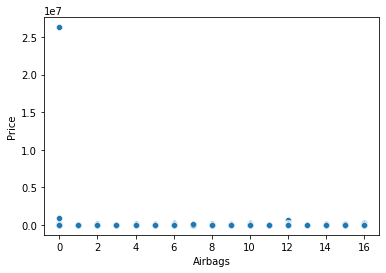

In [27]:
sns.scatterplot(data=df,x='Airbags',y='Price')

In [28]:
index = df[df['Price'] > 600000].index

In [29]:
index

Int64Index([1225, 8541, 16983], dtype='int64')

In [30]:
df.drop(index=index, axis=1,inplace=True)

In [31]:
df.isnull().sum()

ID                    0
Levy                  0
Manufacturer          0
Model                 0
Prod. year            0
Category              0
Leather interior      0
Fuel type             0
Engine volume         0
Mileage               0
Cylinders             0
Gear box type         0
Drive wheels          0
Doors                 0
Wheel                 0
Color                 0
Airbags               0
Price                 0
Cylinder_mean         0
Gear box type_mean    0
Color_mean            0
Category_mean         0
Doors_mean            0
Wheel_mean            0
dtype: int64

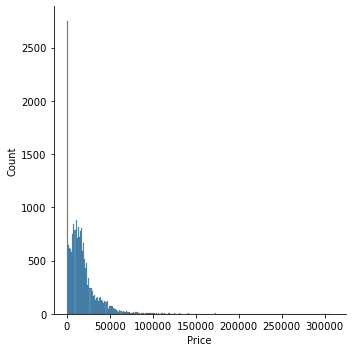

In [32]:
sns.displot(df['Price'])

In [33]:
from scipy import stats

In [34]:
# box = stats.boxcox(df['Price'])

In [35]:
# sns.histplot(box)

In [36]:
# fig = plt.figure()
# ax1 = fig.add_subplot(211)
# x = stats.loggamma.rvs(5, size=500) + 5
# prob = stats.probplot(x, dist=stats.norm, plot=ax1)
# ax1.set_xlabel('')
# ax1.set_title('Probplot against normal distribution')

# # We now use `boxcox` to transform the data so it's closest to normal:

# ax2 = fig.add_subplot(212)
# xt, _ = stats.boxcox(x)
# prob = stats.probplot(xt, dist=stats.norm, plot=ax2)
# ax2.set_title('Probplot after Box-Cox transformation')

# plt.show()

In [37]:
# sns.displot(box)

In [38]:
# df2[df2['Price']>22075]

In [39]:
# log = np.log1p(df2['Price'])
# log.skew()

In [40]:
# log = np.log(df2['Price'])
# log.skew()

In [41]:
# log = np.sqrt(np.sqrt(df2['Price']))
# log.skew()

In [42]:
# sns.histplot(np.sqrt(np.sqrt(df2['Price'])))

In [43]:
# sample = df2['Price']

In [44]:
# sample.describe()

In [45]:
# IQR = 22075-5331
# lower_limit = 1.5*IQR - 5331
# upper_limit = 22075 - 1.5*IQR

In [46]:
# lower_limit

In [47]:
# upper_limit

In [48]:
# np.percentile(sample,[75,25])

In [49]:
# df2.corr()['Price'].sort_values()

In [50]:
# sns.boxplot(sample)

In [51]:
# sns.distplot(np.cbrt(df['Price']))

<AxesSubplot:>

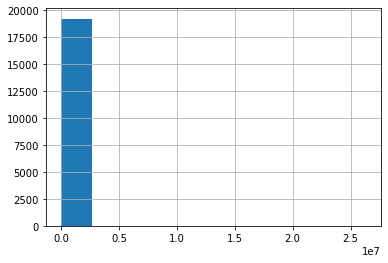

In [52]:
df2['Price'].hist()

In [53]:
df['Model'].value_counts()

Prius                  1083
Sonata                 1079
Camry                   938
Elantra                 922
E 350                   542
                       ... 
520 I                     1
Elantra se                1
3796                      1
M550                      1
Tacoma TRD Off Road       1
Name: Model, Length: 1588, dtype: int64

In [54]:
# df['Model1'] = df['Model'].replace(regex=True, to_replace=r'', value=r'')

In [55]:
# df['Model1'] = df['Model'].str.split()[:-1]

In [56]:
# a = df['Model1'].iloc[305].split()[:-1]

In [57]:
# ''.join(a)

In [58]:
df['Price'].value_counts()

15681    280
470      274
14113    244
392      242
314      235
        ... 
14686      1
12639      1
18800      1
16753      1
16408      1
Name: Price, Length: 2312, dtype: int64

In [59]:
index2 = df[df['Price'] <10].index

In [60]:
index2

Int64Index([  221,   476,   753,  1164,  4776,  4958,  5344,  5890,  7276,
             7359,  7815,  8454,  8993,  9730, 10885, 11636, 12917, 13419,
            14492, 14642, 15347, 16992, 17596, 18575],
           dtype='int64')

In [61]:
df.drop(index=index2,axis=1,inplace=True)

In [62]:
df.drop('ID', axis=1, inplace=True)

test.drop('ID', axis=1, inplace=True)

In [63]:
df['Levy'] = df['Levy'].replace('-', 0)

test['Levy'] = test['Levy'].replace('-', 0)

In [64]:
df['Levy'] = df['Levy'].apply(lambda x: int(x))

test['Levy'] = test['Levy'].apply(lambda x: int(x))

In [65]:
df['Levy'].describe()

count    19210.000000
mean       632.915877
std        567.668348
min          0.000000
25%          0.000000
50%        642.000000
75%        917.000000
max      11714.000000
Name: Levy, dtype: float64

In [66]:
def levy(num):
    if num ==0:
        num = 632
    else:
        pass
    return num

In [67]:
# df['Levy'] = df['Levy'].apply(levy)

# test['Levy'] = test['Levy'].apply(levy)

In [68]:
df.corr()['Price']

Levy                  0.039905
Prod. year            0.286397
Cylinders             0.103148
Airbags              -0.018314
Price                 1.000000
Cylinder_mean         0.135943
Gear box type_mean    0.121450
Color_mean            0.020121
Category_mean         0.060899
Doors_mean           -0.004630
Wheel_mean            0.130196
Name: Price, dtype: float64

In [69]:
def turbo_engine(text):
    if re.findall(r'\d{1,}.\d{1,} Turbo', text):
        text = 5
    else:
        text = 0
    return text

In [70]:
df['Turbo'] = df['Engine volume'].apply(turbo_engine)

test['Turbo'] = test['Engine volume'].apply(turbo_engine)

In [71]:
def engine_volume(text):
    if re.findall(r'\d{1,}.\d{1,} Turbo', text):
        text = text.replace('Turbo',  '')
    else:
        pass
    return float(text)

In [72]:
df['Engine volume'] = df['Engine volume'].apply(engine_volume)

test['Engine volume'] = test['Engine volume'].apply(engine_volume)

In [73]:
def mileage(text):
    if re.findall(r'\d{1,} km', text):
        text = text.replace(' km',  '')
    else:
        None
    return int(text)

In [74]:
df['Mileage'] = df['Mileage'].apply(mileage)

test['Mileage'] = test['Mileage'].apply(mileage)

In [75]:
def doors(text):
    if text == '>5':
        text = 7
    elif text == '2-Mar':
        text = 3
    else:
        text = 5
    return int(text)
    

In [76]:
df['No. of doors'] = df['Doors'].apply(doors)

test['No. of doors'] = test['Doors'].apply(doors)

In [77]:
df.groupby('Fuel type').mean().sort_values('Price',ascending=False)

,Levy,Prod. year,Engine volume,Mileage,Cylinders,Airbags,Price,Cylinder_mean,Gear box type_mean,Color_mean,Category_mean,Doors_mean,Wheel_mean,Turbo,No. of doors
Fuel type,,,,,,,,,,,,,,,
Diesel,746.407536,2010.964056,2.386118,7.119253e+05,4.539167,5.424145,24124.814328,18053.171542,18439.221616,18569.186911,24921.353495,18805.803669,19274.814080,1.062221,4.922657
Plug-in Hybrid,215.697674,2013.093023,1.654651,1.219321e+05,4.093023,9.209302,23700.453488,18683.918605,17224.093023,17679.651163,12933.395349,17180.000000,19241.337209,0.174419,5.000000
Hydrogen,0.000000,2012.000000,2.400000,1.168000e+05,6.000000,8.000000,20385.000000,16618.000000,26448.000000,19203.000000,14231.000000,17180.000000,19363.000000,0.000000,5.000000
Petrol,645.365225,2010.859992,2.361700,1.133099e+06,4.717812,6.857326,17266.970873,18888.732129,19223.309834,18739.646031,17426.658175,19005.887441,18349.551836,0.500099,4.904818
LPG,587.946128,2012.007856,2.234456,2.722804e+05,4.344557,4.639731,13324.372615,18528.806958,17458.475870,16152.508418,15871.746352,17475.294052,18517.505051,0.067340,4.997755
Hybrid,567.781381,2012.183953,2.079815,4.718248e+05,4.272854,7.783338,10852.351132,18206.745597,16550.035784,18602.020129,14909.256919,17257.848476,18476.701705,0.036343,5.001118
CNG,76.436105,2000.081136,2.481542,2.238497e+07,4.920892,4.780933,8526.839757,18331.709939,22375.448276,18741.655172,21870.659229,18708.373225,17410.472617,0.152130,4.959432


In [78]:
df['Leather'] = df['Leather interior'].apply(lambda x: 5 if x == 'Yes' else 0)

test['Leather'] = test['Leather interior'].apply(lambda x: 5 if x == 'Yes' else 0)

In [79]:
# df.drop('Leather interior',axis=1,inplace=True)

# test.drop('Leather interior',axis=1,inplace=True)

In [80]:
# df.drop('Doors', axis=1, inplace=True)

# test.drop('Doors', axis=1, inplace=True)

In [81]:
# df.drop('Manufacturer', axis=1, inplace=True)

# test.drop('Manufacturer', axis=1, inplace=True)

In [82]:
# df.drop('Model', axis=1, inplace=True)

# test.drop('Model', axis=1, inplace=True)

In [83]:
df['Cylinders Airbags'] = df['Cylinders'] * df['Airbags']

test['Cylinders Airbags'] = test['Cylinders'] * test['Airbags']

In [84]:
df['Engine volume Airbags'] = df['Engine volume'] * df['Airbags']

test['Engine volume Airbags'] = test['Engine volume'] * test['Airbags']

In [85]:
df['Prod. year_age'] = 2021 - df['Prod. year']

test['Prod. year_age'] = 2021 - test['Prod. year']

In [86]:
df

,Levy,Manufacturer,Model,Prod. year,Category,Leather interior,Fuel type,Engine volume,Mileage,Cylinders,...,Color_mean,Category_mean,Doors_mean,Wheel_mean,Turbo,No. of doors,Leather,Cylinders Airbags,Engine volume Airbags,Prod. year_age
0,1399,LEXUS,RX 450,2010,Jeep,Yes,Hybrid,3.5,186005,6,...,15091,23684,17180,19363,0,5,5,72,42.0,11
1,1018,CHEVROLET,Equinox,2011,Jeep,No,Petrol,3.0,192000,6,...,18886,23684,17180,19363,0,5,0,48,24.0,10
2,0,HONDA,FIT,2006,Hatchback,No,Petrol,1.3,200000,4,...,18886,11381,17180,8900,0,5,0,8,2.6,15
3,862,FORD,Escape,2011,Jeep,Yes,Hybrid,2.5,168966,4,...,18204,23684,17180,19363,0,5,5,0,0.0,10
4,446,HONDA,FIT,2014,Hatchback,Yes,Petrol,1.3,91901,4,...,15091,11381,17180,19363,0,5,5,16,5.2,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19232,0,MERCEDES-BENZ,CLK 200,1999,Coupe,Yes,CNG,2.0,300000,4,...,15091,21250,50379,19363,5,3,5,20,10.0,22
19233,831,HYUNDAI,Sonata,2011,Sedan,Yes,Petrol,2.4,161600,4,...,13553,14231,17180,19363,0,5,5,32,19.2,10
19234,836,HYUNDAI,Tucson,2010,Jeep,Yes,Diesel,2.0,116365,4,...,19203,23684,17180,19363,0,5,5,16,8.0,11
19235,1288,CHEVROLET,Captiva,2007,Jeep,Yes,Diesel,2.0,51258,4,...,18886,23684,17180,19363,0,5,5,16,8.0,14


In [87]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 19210 entries, 0 to 19236
Data columns (total 29 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   Levy                   19210 non-null  int64  
 1   Manufacturer           19210 non-null  object 
 2   Model                  19210 non-null  object 
 3   Prod. year             19210 non-null  int64  
 4   Category               19210 non-null  object 
 5   Leather interior       19210 non-null  object 
 6   Fuel type              19210 non-null  object 
 7   Engine volume          19210 non-null  float64
 8   Mileage                19210 non-null  int64  
 9   Cylinders              19210 non-null  int64  
 10  Gear box type          19210 non-null  object 
 11  Drive wheels           19210 non-null  object 
 12  Doors                  19210 non-null  object 
 13  Wheel                  19210 non-null  object 
 14  Color                  19210 non-null  object 
 15  Ai

In [88]:
price = df['Price']
df = df.drop('Price',axis=1)
df['label'] = 1
test['label'] = 2

concat_df_test = pd.concat([df , test])
df_objects = concat_df_test.select_dtypes(include='object')
df_numeric = concat_df_test.select_dtypes(exclude='object')

# Create your dummies
df_obj_dummies = pd.get_dummies(df_objects)
features_df = pd.concat([df_obj_dummies, df_numeric], axis=1)

# Split your data
df = features_df[features_df['label'] == 1]
test = features_df[features_df['label'] == 2]

# Drop your labels
df = df.drop('label', axis=1)
df = pd.concat([df,price],axis=1)
test = test.drop('label', axis=1)

In [89]:
lst1 = [x for x in df.columns.tolist() if 'Model_' in x]
        
lst2 = ['Model'+str(x) for x in range(len(lst1))]

d = dict(zip(lst1, lst2))

df.rename(columns=d, inplace=True)
test.rename(columns=d, inplace=True)

In [90]:
# df_uint = df.select_dtypes(include='uint8')
# df_int64 = df.select_dtypes(include='int64')
# df_int64 = df_int64.astype(np.int16)
# df = pd.concat([df_int64, df_uint], axis=1)

# test_uint = test.select_dtypes(include='uint8')
# test_int64 = test.select_dtypes(include='int64')
# test_int64 = test_int64.astype(np.int16)
# test = pd.concat([test_int64, test_uint], axis=1)

In [91]:
X = df.drop('Price',axis=1)
y = df['Price']

In [92]:
from sklearn.model_selection import train_test_split

In [93]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)

In [94]:
from sklearn.preprocessing import MinMaxScaler

In [95]:
scaler = MinMaxScaler()

In [96]:
# X_train = scaler.fit_transform(X_train)
# X_test = scaler.transform(X_test)

# test = scaler.transform(test)

In [97]:
from sklearn.pipeline import Pipeline
from catboost import CatBoostRegressor
import xgboost as xgb
import lightgbm as lgb
from sklearn.ensemble import RandomForestRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import AdaBoostRegressor, BaggingRegressor, ExtraTreesRegressor, GradientBoostingRegressor, StackingRegressor, VotingRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error, mean_squared_log_error
from sklearn.model_selection import GridSearchCV

In [98]:
def run_model(model, X_train, y_train, X_test, y_test):
    
    # Fit Model Training
    log_y_train = np.log1p(y_train)
    model.fit(X_train, log_y_train)
    
    # Get Metrics
    preds = model.predict(X_test)
#     preds = abs(preds)

    rmsle = np.sqrt(mean_squared_log_error(y_test, np.expm1(preds)))
    print(f'RMSLE: {rmsle}')

In [99]:
model = lgb.LGBMRegressor()

run_model(model, X_train, y_train, X_test, y_test)

RMSLE: 0.9870573810866228


In [100]:
model = lgb.LGBMRegressor(boosting_type='gbdt', n_estimators=760, max_depth=-1, learning_rate=0.11, num_leaves=31)

run_model(model, X_train, y_train, X_test, y_test)

RMSLE: 0.9347439309895064


In [101]:
# model = lgb.LGBMRegressor(n_estimators=10000, num_leaves=70, max_depth=20,min_child_samples=10, 
#                           learning_rate=0.01, colsample_bytree=0.8,subsample=0.5, reg_alpha=0, reg_lambda=20)

# run_model(model, X_train, y_train, X_test, y_test)

In [102]:
from sklearn.model_selection import RandomizedSearchCV,GridSearchCV

In [ ]:
# log_y_train = np.log1p(y_train)
# model = RandomForestRegressor()
# param_grid = {'n_estimators':[10,100,300,500,600,700,1000], 
#               'max_depth':[1,2,5,10,100,500,600,800,1000],
#              'min_samples_split':[0.1,1,2,5,10,100,1000], 
#               'min_samples_leaf':[0.1,1,2,5,10,100,1000], 
#               'min_weight_fraction_leaf':[0.1,1,2,5,10,100,1000], 
#               'max_features':['auto','sqrt','log2',10,100,300,500,700,1000], 
#               'max_leaf_nodes':[2,5,10,100,1000]                            
#              }

# grid = GridSearchCV(model, param_grid,verbose=2)
# run_model(grid, X_train, y_train, X_test, y_test)

Fitting 5 folds for each of 972405 candidates, totalling 4862025 fits
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.3s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.5s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.3s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.3s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.3s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1,

C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=500; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=500; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   1.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   1.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   1.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   1.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   1.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.9s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.5s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.5s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.4s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.6s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=0.1, n_estimators=10; total ti

C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=600; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=600; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=600; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=700; total time=   1.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=700; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=700; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=600; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=600; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=600; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.2s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.2s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.2s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.2s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=0.1, n_estimators=10; total ti

C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.3s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.2s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.2s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.2s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=0.1, n_estimators=10; tot

C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.2s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.3s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.2s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.2s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=0.1, n_estimators=1

C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=600; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=600; total time=   1.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=600; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=700; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.4s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.4s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.3s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.4s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=0.1, n_estima

C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=700; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=700; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   1.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   1.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=0.1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.5s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.3s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.4s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.5s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=0.1, n_estimators=10; total

C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=100; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=600; total time=   1.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=700; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=700; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=700; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   1.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.9s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.5s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.5s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.6s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.5s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.5s
[

C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=600; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=600; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=600; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=700; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=700; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.3s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.2s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.2s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.3s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.4s
[

C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=500; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=1000; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.9s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.2s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.2s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.3s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.2s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1

C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=500; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=500; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=500; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=500; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=600; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=600; total time=   1.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=600; total time=   1.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=600; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=600; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=700; total time=   1.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=700; total time=   2.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=700; total time=   1.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=700; total time=   1.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=700; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=1000; total time=   1.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=100; total time=   1.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=300; total time=   1.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=300; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=1000; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.3s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.3s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.3s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.3s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=0.1, n_estimators=10; total tim

C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=700; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=700; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=700; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=700; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=1000; total time=   1.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=1000; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=1000; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=1000; total time=   1.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=1000; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=600; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=600; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=600; total time=   1.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=600; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=600; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=700; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=700; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=700; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=700; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=1000; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=1000; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=500; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=600; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=700; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=1000; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.3s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.3s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.3s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.3s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=0.1, n_estimators=10; tot

C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=700; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=1, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.2s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.3s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.3s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.6s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=0.1, n_estimators=10; total t

C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=500; total time=   0.5s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=600; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=1000; total time=   1.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   1.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   1.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   1.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   1.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=600; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=700; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.3s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.2s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.2s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.2s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.3s
[

C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=1000; total time=   1.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=600; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=1000; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   1.2s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.8s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.8s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.6s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.6s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.4s
[

C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=700; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.4s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.4s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.4s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.5s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1

C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=700; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=700; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=700; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=700; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=700; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=1000; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.5s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.5s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.6s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.8s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=0.1, n_estimators=10; total tim

C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.7s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=700; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=1000; total time=   1.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=1000; total time=   1.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=1000; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=1000; total time=   1.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=1000; total time=   1.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=500; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=500; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=600; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.3s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.4s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.2s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.3s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=0.1, n_estimators=10; tot

C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=600; total time=   1.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=600; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=700; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=1000; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=1000; total time=   1.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=1000; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=1000; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=1000; total time=   1.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=700; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=1000; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=1000; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=600; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=1000; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=600; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=600; total time=   1.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=600; total time=   1.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=600; total time=   2.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=600; total time=   1.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=700; total time=   1.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=700; total time=   1.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=700; total time=   1.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=700; total time=   1.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=700; total time=   1.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=1000; total time=   1.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=1000; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=1000; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=1000; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=1000; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=300; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=600; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=700; total time=   1.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=2, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   1.0s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.4s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.4s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.4s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.5s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=0.1, n_estimators=10; total t

C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=700; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=600; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=700; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=700; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=600; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=600; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   1.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=700; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=500; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=500; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=500; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=600; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=600; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=600; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.3s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.3s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.5s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.4s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.2s
[

C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=700; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.2s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.2s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.6s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.3s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.2s
[

C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=600; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=700; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.2s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.2s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.3s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.2s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1

C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=1000; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=600; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=600; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=600; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=600; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=700; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=600; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=700; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=1000; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=1000; total time=   1.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   1.0s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.5s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.4s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.4s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.5s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=0.1, n_estimators=10; total tim

C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=700; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.4s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=600; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=700; total time=   1.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=700; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=700; total time=   1.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=700; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=700; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   1.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   1.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   1.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   1.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   1.5s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.5s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.6s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.5s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.4s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=0.1, n_estimators=10; tot

C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=1000; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=5, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.4s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.3s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.3s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.2s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=0.1, n_estimators=10; to

C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=700; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   1.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   1.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=600; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=700; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=700; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=700; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=700; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=700; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   1.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   1.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   1.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   1.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=500; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=500; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=500; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=500; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=500; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=600; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=600; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=600; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.2s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.3s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.3s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.2s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   

C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=600; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=700; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=700; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=700; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   1.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.9s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.4s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.3s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.2s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.3s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   

C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=700; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=5, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.4s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.4s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.5s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.5s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=0.1, n_estimators=10; total tim

C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=600; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=500; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=500; total time=   1.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=500; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=600; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=600; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=600; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=600; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=600; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=700; total time=   1.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=700; total time=   1.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=700; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=1000; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=100, n_estimators=1000; total time=   1.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=10, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   1.0s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.5s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.5s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.7s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.5s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=0.1, n_estimators=10; tot

C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=700; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=700; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=1000; total time=   1.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=1000; total time=   1.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=1000; total time=   1.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=1000; total time=   1.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=2, n_estimators=1000; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=100, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.3s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.6s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.3s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.3s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=0.1, n_estimators=1

C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=700; total time=   1.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=700; total time=   2.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=700; total time=   1.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=1000; total time=   1.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=1000; total time=   1.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=1000; total time=   1.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=1000; total time=   1.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1, n_estimators=1000; total time=   1.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=300; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=300; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=500; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=500; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=500; total time=   1.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=500; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=500; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=600; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=600; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=600; total time=   1.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=600; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=600; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=700; total time=   1.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=700; total time=   1.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=700; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=700; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=700; total time=   1.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=1000; total time=   1.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=1000; total time=   1.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=1000; total time=   1.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=1000; total time=   1.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=2, n_estimators=1000; total time=   1.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=100; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=300; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=300; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=300; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=500; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=500; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=500; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=500; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=500; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=600; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=600; total time=   1.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=600; total time=   1.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=600; total time=   1.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=600; total time=   1.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=700; total time=   2.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=700; total time=   1.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=700; total time=   1.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=700; total time=   2.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=700; total time=   1.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=1000; total time=   1.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=1000; total time=   1.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=1000; total time=   1.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=1000; total time=   1.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=5, n_estimators=1000; total time=   1.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=10, min_samples_split=1000, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.2s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.3s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.2s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.2s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=0.1, n_estimators=

C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=100; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=500; total time=   1.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=500; total time=   1.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=700; total time=   1.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   1.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=600; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=700; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=700; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=700; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=100; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=500; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=500; total time=   1.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=500; total time=   1.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=500; total time=   1.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=600; total time=   1.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=600; total time=   1.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=600; total time=   1.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=600; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=600; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=700; total time=   1.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=700; total time=   1.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=700; total time=   1.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=700; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=700; total time=   1.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   1.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   1.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   2.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=300; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=500; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=500; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=500; total time=   1.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=500; total time=   1.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=500; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=600; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=600; total time=   1.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=600; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=700; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=700; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   1.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=300; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=500; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=500; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=600; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=600; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=700; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=700; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=700; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=700; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=700; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=0.1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=600; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=700; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=700; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=0.1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=600; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=700; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=700; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=700; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1, n_estimators=1000; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=700; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=700; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=2, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=5, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=10, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=300; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=300; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=500; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=500; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=500; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=600; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=600; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=600; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=700; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=100, n_estimators=1000; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=700; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=1, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.9s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.3s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.2s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.3s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.3s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=0.1, n_estimators=10; total ti

C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=100; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=500; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=700; total time=   2.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=700; total time=   1.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=700; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=700; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=1000; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=1000; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1, n_estimators=1000; total time=   1.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=10; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=100; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=100; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=100; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=300; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=300; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=300; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=500; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=500; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=500; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=500; total time=   1.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=500; total time=   2.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=600; total time=   2.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=600; total time=   1.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=600; total time=   1.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=600; total time=   1.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=600; total time=   1.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=700; total time=   1.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=700; total time=   1.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=700; total time=   1.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=700; total time=   1.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=700; total time=   2.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=1000; total time=   2.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=1000; total time=   2.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=1000; total time=   2.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=1000; total time=   2.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=2, n_estimators=1000; total time=   2.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=10; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=10; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=10; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=10; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=10; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=100; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=100; total time=   1.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=100; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=100; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=100; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=300; total time=   1.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=300; total time=   1.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=300; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=300; total time=   1.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=300; total time=   1.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=500; total time=   1.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=500; total time=   1.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=500; total time=   1.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=500; total time=   1.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=500; total time=   1.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=600; total time=   1.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=600; total time=   1.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=600; total time=   1.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=600; total time=   1.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=600; total time=   2.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=700; total time=   1.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=700; total time=   1.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=700; total time=   1.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=700; total time=   2.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=700; total time=   1.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=1000; total time=   2.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=1000; total time=   2.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=1000; total time=   1.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=1000; total time=   1.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=5, n_estimators=1000; total time=   2.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=10; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=10; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=100; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=100; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=100; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=300; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=300; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=300; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=300; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=300; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=500; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=500; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=500; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=500; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=500; total time=   1.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=600; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=600; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=600; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=600; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=700; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=700; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=700; total time=   1.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=700; total time=   1.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=700; total time=   1.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=1000; total time=   2.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=1000; total time=   1.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=1000; total time=   1.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=1000; total time=   2.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=10, n_estimators=1000; total time=   1.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=10; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=10; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=100; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=300; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=300; total time=   1.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=300; total time=   1.1s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=500; total time=   1.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=500; total time=   1.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=500; total time=   1.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=500; total time=   1.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=500; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=600; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=600; total time=   1.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=600; total time=   1.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=600; total time=   1.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=600; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=700; total time=   1.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=700; total time=   1.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=700; total time=   1.3s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=700; total time=   1.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=700; total time=   1.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=1000; total time=   1.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=1000; total time=   1.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=1000; total time=   1.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=1000; total time=   2.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=100, n_estimators=1000; total time=   1.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=10; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=10; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=100; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=300; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=500; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.6s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.7s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=600; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=600; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=700; total time=   1.2s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=700; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=700; total time=   1.8s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=700; total time=   1.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=700; total time=   1.4s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   1.5s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   1.0s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   0.9s


C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py:615: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\model_selection\_validation.py", line 598, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\sklearn\ensemble\_forest.py", line 387, in fit
    trees = Parallel(n_jobs=self.n_jobs, verbose=self.verbose,
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 1048, in __call__
    if self.dispatch_one_batch(iterator):
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\parallel.py", line 866, in dispatch_one_batch
    self._dispatch(tasks)
  File "C:\Users\akumar5\AppData\Local\Anaconda\lib\site-packages\joblib\pa

[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=2, min_weight_fraction_leaf=1000, n_estimators=1000; total time=   1.1s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=5, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.5s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=5, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.5s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=5, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.8s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=5, min_weight_fraction_leaf=0.1, n_estimators=10; total time=   1.4s
[CV] END max_depth=1, max_features=auto, max_leaf_nodes=2, min_samples_leaf=100, min_samples_split=5, min_weight_fraction_leaf=0.1, n_estimators=10; total ti

In [ ]:
# run_model(grid, X_train, y_train, X_test, y_test)

In [ ]:
# grid.fit(X_train, log_y_train)

In [ ]:
# model = lgb.LGBMRegressor(boosting_type='gbdt', n_estimators=760, max_depth=-1, learning_rate=0.11, num_leaves=31)
# model = RandomForestRegressor(n_estimators=500, max_features=500)
# model = lgb.LGBMRegressor(n_estimators=10000, num_leaves=70, max_depth=20,min_child_samples=10, 
#                           learning_rate=0.01, colsample_bytree=0.8,subsample=0.5, reg_alpha=0, reg_lambda=20)
# model = xgb.XGBRegressor(n_estimators=1000, max_depth=12, learning_rate=0.05, colsample_bytree=0.45)

# log_y = np.log1p(y)
# model.fit(X, log_y)
# predictions = pd.DataFrame(np.expm1(model.predict(test)), columns=['Price'])
# predictions.to_csv('predictions.csv',index=False)

In [ ]:
# param_grid = {'boosting_type': ['gbdt','dart','goss','rf'], 'num_leaves':[31, 40, 50, 75, 100],
#              'max_depth':[-1,1,10], 'learning_rate':[0.001,0.01,0.05,0.1,0.3,0.5,1],
#              'n_estimators':[100,500,1000,2000,3000,5000,10000]}

In [ ]:
# model = RandomForestRegressor()

# run_model(model, X_train, y_train, X_test, y_test)

In [ ]:
# model = RandomForestRegressor(n_estimators=500, max_features=500)

# run_model(model, X_train, y_train, X_test, y_test)

In [ ]:
# model = AdaBoostRegressor()

# run_model(model, X_train, y_train, X_test, y_test)

In [ ]:
# model = GradientBoostingRegressor()

# run_model(model, X_train, y_train, X_test, y_test)

In [ ]:
# model = CatBoostRegressor()

# run_model(model, X_train, y_train, X_test, y_test)

In [ ]:
# model = CatBoostRegressor(n_estimators=2000, learning_rate=0.05, max_depth=9, rsm=0.5)

# run_model(model, X_train, y_train, X_test, y_test)

In [ ]:
# model = xgb.XGBRegressor()

# run_model(model, X_train, y_train, X_test, y_test)

In [ ]:
# model = xgb.XGBRegressor(n_estimators=1000, max_depth=12, learning_rate=0.05, colsample_bytree=0.45)

# run_model(model, X_train, y_train, X_test, y_test)

In [ ]:
# model = xgb.XGBRFRegressor()

# run_model(model, X_train, y_train, X_test, y_test)

In [ ]:
# !pip install -q -U git+https://github.com/mljar/mljar-supervised.git@master

In [ ]:
# pip install mljar-supervised

In [ ]:
# from supervised.automl import AutoML

In [ ]:
# !pip install autoviml

In [ ]:
# from autoviml.Auto_ViML import Auto_ViML

In [ ]:
# target = 'Price'
# model, features, trainm, testm = Auto_ViML(
#     df,
#     target,
#     test,
#     sub,
#     hyper_param="RS",
#     feature_reduction=False,
#     scoring_parameter= "neg_mean_squared_log_error",
#     KMeans_Featurizer=True,
#     Boosting_Flag= False,
#     Binning_Flag=False,
#     Add_Poly=1,
#     Stacking_Flag=False,
#     Imbalanced_Flag=False,
#     verbose=2
# )

In [ ]:
# df['Price'] = np.log1p(df['Price'])
# target = 'Price'

# model, features, trainm, testm = Auto_ViML(
#     df,
#     target,
#     test,
#     sub,
#     hyper_param="RS",
#     feature_reduction=False,
#     scoring_parameter= "neg_mean_squared_log_error",
#     KMeans_Featurizer=True,
#     Boosting_Flag= False,
#     Binning_Flag=False,
#     Add_Poly=1,
#     Stacking_Flag=False,
#     Imbalanced_Flag=False,
#     verbose=2
# )

In [ ]:
# sub

In [ ]:
# from supervised.automl import AutoML # mljar-supervised